In [1]:
""""
Bug in VS code cell insertion still being resolved (thus the comments here instead of markdown.

Resources:
VS Code issue: https://github.com/microsoft/vscode-python/issues/8194

Bioformats Python importer tutorial: https://github.com/bioimage-analysis/load_image_bioformats/blob/master/Example_usage_bioformats.ipynb
    - Note that the above tutorial seems old and has parts that no longer work
    - This will be helpful:
        https://pythonhosted.org/python-bioformats/


BFI CLI tutorial: https://cespenel.github.io/guides/3-Loading_microscopy_images/

javabridge install: https://anaconda.org/anaconda/javabridge
    - javabridge install did not work, installed binary directly from here and 
      installed with pip:
        https://www.lfd.uci.edu/~gohlke/pythonlibs/#javabridge


correct python-bioformats install: https://pypi.org/project/python-bioformats/

note: to be able to access functions in src rile, run (at root of project folder):
    pip install --editable . 
"""



import javabridge
import bioformats
import numpy as np
import matplotlib.pyplot as plt 

# Start javabridge
javabridge.start_vm(class_path=bioformats.JARS)


In [1]:
img_path = "data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E/1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_1_DG.czi"

# Below loads only the first z plane for all 3 channels
test_im = bioformats.load_image(img_path)
test_im

NameError: name 'bioformats' is not defined

In [3]:
test_im.shape

(512, 512, 3)

In [4]:
from src.visualization.plot_3c import plot_3c

Shape:  (512, 512, 3)
Type: <class 'numpy.ndarray'>
Dtype: float32


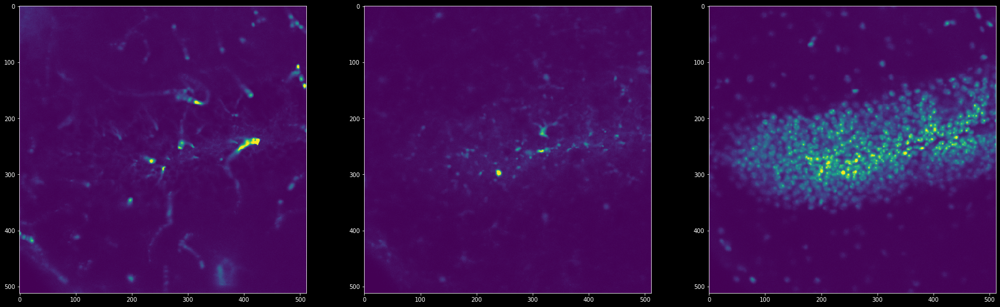

In [5]:
test_fig = plot_3c(test_im)

In [6]:
test_im_class = bioformats.ImageReader(img_path)
print("Type:", type(test_im_class))

Type: <class 'bioformats.formatreader.ImageReader'>


In [7]:
x = test_im_class.read(c = 0, z)

SyntaxError: positional argument follows keyword argument (<ipython-input-7-127e8ad1524a>, line 1)

In [16]:
test_im_class.metadata

<Java object at 0x-129046e8>

In [17]:
test_meeta = bioformats.get_omexml_metadata(img_path)

AttributeError: 'NoneType' object has no attribute 'find_class'

In [18]:
meta = bioformats.OMEXML(test_meeta)

In [19]:
import skimage as sk
meta.image().Pixels.get_PhysicalSizeX()

0.6666666666666666

In [20]:
x = test_im_class.read(series = True)

AttributeError: 'NoneType' object has no attribute 'find_class'

In [24]:
def bioformats_importer(image_path):
    # Start javabridge
    javabridge.start_vm(class_path=bioformats.JARS)
    
    # Get Image
    im_clob = bioformats.ImageReader(image_path)
    image_0 = im_clob.read(z = 0, rescale = False)
    image_1 = im_clob.read(z = 1, rescale = False)
    image_2 = im_clob.read(z = 2, rescale = False)
    image = np.stack((image_0, image_1, image_2), axis = 1)
    
    # Get Metadata 
    meta_clob = bioformats.get_omexml_metadata(image_path)
    meta = bioformats.OMEXML(meta_clob)

    # Kill Javabridge
    javabridge.kill_vm()

    
    return image, meta

In [25]:

im, meta = bioformats_importer(img_path)

Traceback (most recent call last):
  File "C:\python\lib\site-packages\javabridge\jutil.py", line 281, in start_thread
    env = vm.create(args)
  File "_javabridge.pyx", line 654, in _javabridge.JB_VM.create
RuntimeError: Failed to create Java VM. Return code = -5
Failed to create Java VM


RuntimeError: Failed to start Java VM

In [0]:
im.shape

In [1]:
from src.data.bioformats_importer import bioformats_importer



img_path = "data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E/1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_1_DG.czi"

img, meta = bioformats_importer(img_path)

In [2]:
print (img.shape)
img

(512, 512, 3, 3)


array([[[[ 7826,  1142,  1011],
         [57677,  3928,  2445],
         [ 7453,  1273,  1065]],

        [[ 8109,   851,   793],
         [51299,  4014,  2341],
         [ 8583,  1362,   919]],

        [[ 8410,  1292,   939],
         [55541,  4786,  2502],
         [ 7294,  2229,  1493]],

        ...,

        [[ 2468,  1910,  1670],
         [ 6649,  6185,  4321],
         [ 1387,  1286,  1071]],

        [[ 2030,  2279,  1820],
         [ 6456,  5367,  3711],
         [ 1558,  1339,  1268]],

        [[ 2088,  1790,  3314],
         [ 6743,  4920,  4587],
         [ 1756,  1432,  1206]]],


       [[[ 7378,  1231,   832],
         [60235,  4541,  2453],
         [ 8545,  1696,  1011]],

        [[ 7572,   983,   898],
         [57580,  3426,  2835],
         [ 7959,  1532,  1341]],

        [[ 9105,   899,   966],
         [54371,  3035,  2926],
         [ 8673,  2183,  1183]],

        ...,

        [[ 1931,  2025,  2501],
         [ 6061,  6266,  4270],
         [ 1815,  1367, 

Shape:  (512, 512, 3)
Type: <class 'numpy.ndarray'>
Dtype: uint16


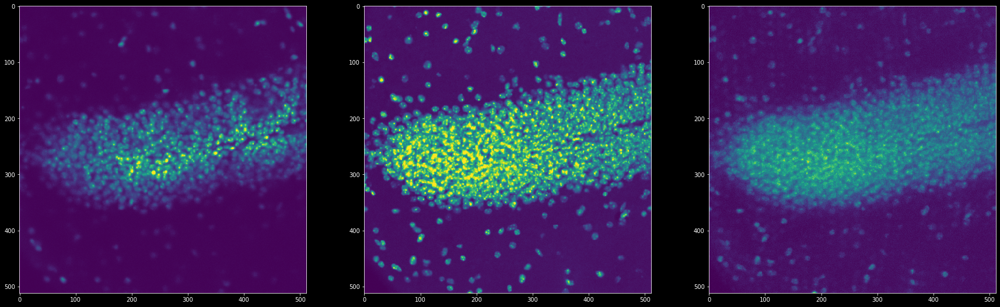

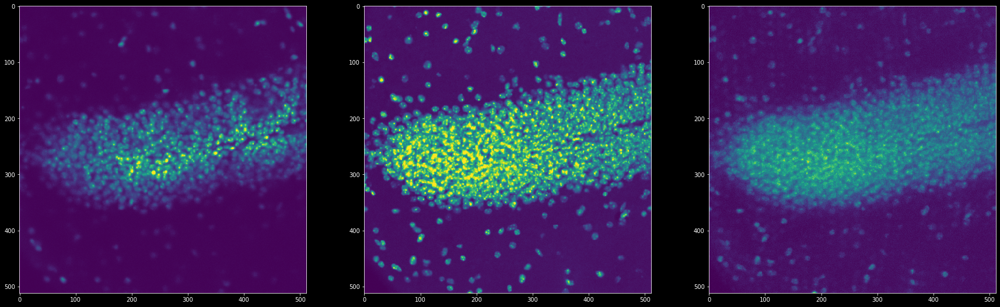

In [10]:
from src.visualization.plot_3c import plot_3c

plot_3c(img[...,2])

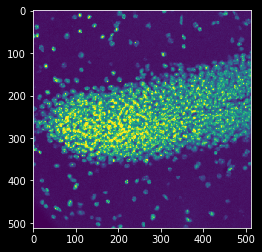

In [9]:
## Test max project
import numpy as np
import matplotlib.pyplot as plt

dapi_max = np.max(img[...,2], axis = 2)
plt.imshow(dapi_max)

Shape:  (512, 512, 3)
Type: <class 'numpy.ndarray'>
Dtype: uint16


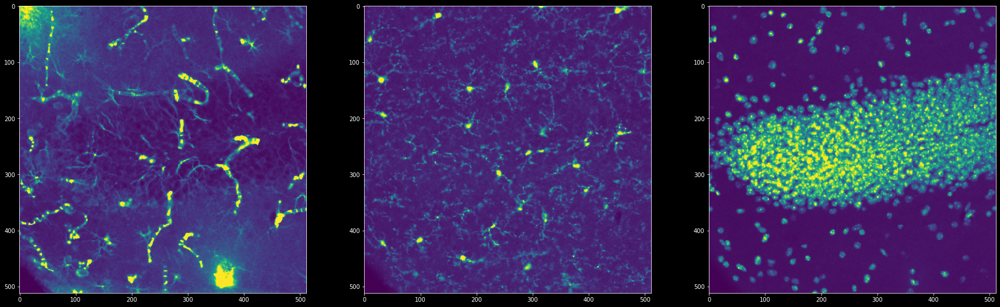

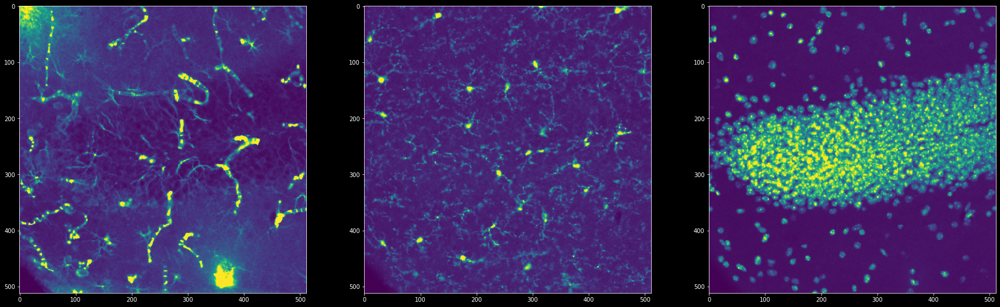

In [12]:
from src.data.maxproject_3c import maxproject_3c

max_im = maxproject_3c(img)
plot_3c(max_im)

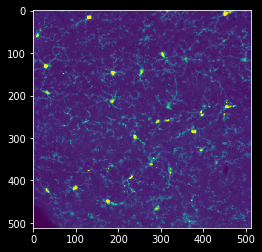

In [13]:
## setup median filter

gfp = max_im[...,1]
plt.imshow(gfp)

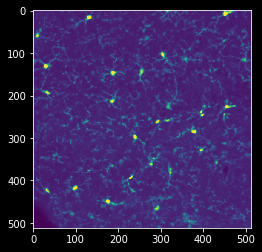

In [14]:
import scipy as sp

despec_gfp = sp.signal.medfilt(gfp, kernel_size= 3)
plt.imshow(despec_gfp)

Shape:  (512, 512, 3)
Type: <class 'numpy.ndarray'>
Dtype: float64


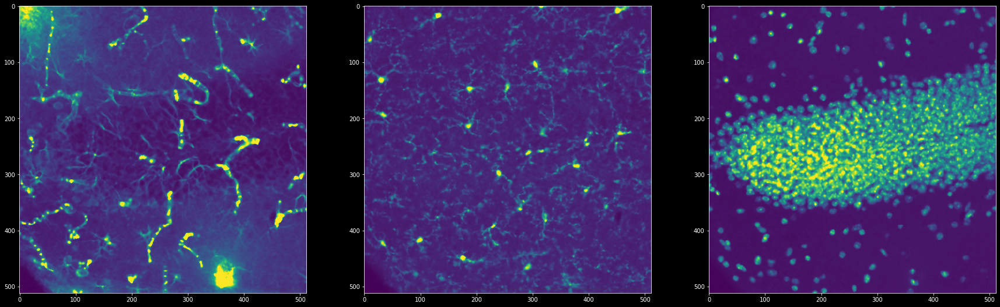

In [17]:
from src.data.median_filt_3c import median_filt_3c

despec_im3c = median_filt_3c(max_im)
x = plot_3c(despec_im3c) 

In [19]:
## make function to iterate through and pre process all images

import skimage as sk




In [28]:
import os

image_dir = "data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E/"

images = sk.io.ImageCollection(os.path.join(image_dir, '*.czi'))

images.files[1]

'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_2_DG.czi'

In [1]:
from src.data.x4_preprocess_batch_images import x4_preprocess_batch_images

image_dir = "data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E/"

test_list = x4_preprocess_batch_images(image_dir)

['data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_1_DG.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_2_DG.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_3_DG.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_4_DG.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_5_DG.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_6_CA3.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_7_CA3.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_8_CA2.czi', 'data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E\\1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_9_CA1.CA2.czi', 'data/raw/AC_10.21.

In [5]:
test = test_list[1:10]
print(test)

[[array([[[    0.,     0.,     0.],
        [ 4514.,  2521.,  1606.],
        [ 4514.,  2521.,  1591.],
        ...,
        [ 7337., 16256.,  8555.],
        [ 6673., 12925., 11204.],
        [    0.,     0.,     0.]],

       [[ 4514.,  2677.,  1880.],
        [ 5030.,  2735.,  2174.],
        [ 5472.,  2705.,  2174.],
        ...,
        [ 7592., 19163., 11132.],
        [ 7527., 15692., 12725.],
        [ 6506., 10752., 11838.]],

       [[ 4732.,  2677.,  1880.],
        [ 5478.,  2735.,  2148.],
        [ 5538.,  2705.,  2223.],
        ...,
        [ 7592., 17845.,  8555.],
        [ 7158., 15692., 12725.],
        [ 6506., 11253., 12497.]],

       ...,

       [[11974.,  4839.,  2511.],
        [12218.,  4851.,  2528.],
        [12171.,  4851.,  2511.],
        ...,
        [10792.,  7147.,  3533.],
        [10666.,  9108.,  3533.],
        [10582.,  9108.,  3274.]],

       [[ 9570.,  4851.,  2511.],
        [12171.,  4973.,  2568.],
        [12274.,  4851.,  2528.],
       

In [10]:
from src.visualization.plot_3c import plot_3c

test[1,0,0].shape

TypeError: list indices must be integers or slices, not tuple

In [11]:
import os


In [15]:
import os
import skimage as sk
image_dir = "data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E/"

images = sk.io.ImageCollection(os.path.join(image_dir, '*.czi'))

images.files[1]

os.path.basename(images.files[1])

'1613E_GFAP.1.1000_Iba1.1.1000_10.21.19_20x_zStack_10um_2_DG.czi'

Shape:  (512, 512, 3)
Type: <class 'numpy.ndarray'>
Dtype: float64


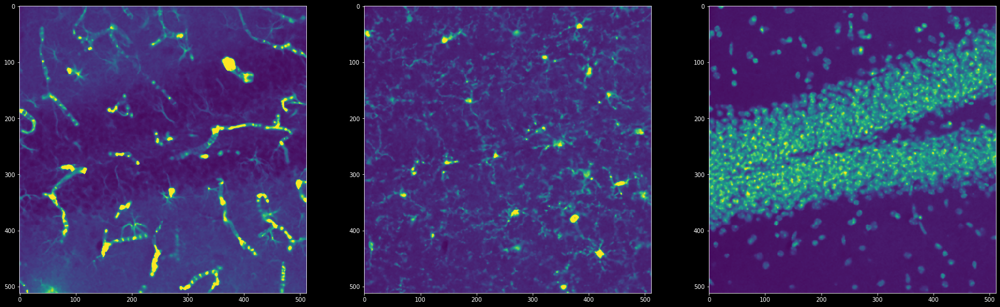

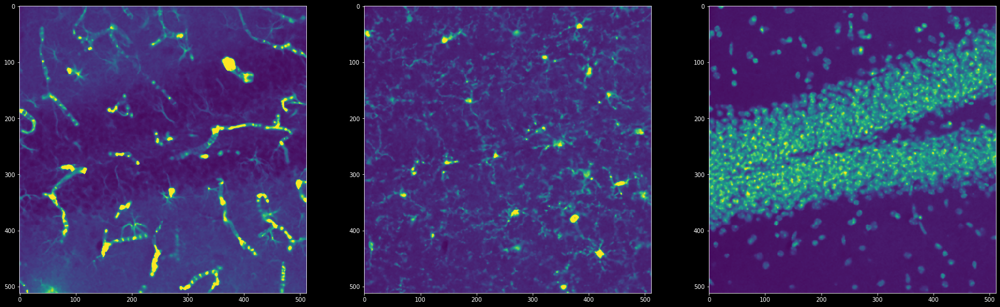

In [20]:
plot_3c(test[0][0])

In [22]:
tmeta = test[0][1]

In [24]:
print(tmeta)

ID="Annotation:562" Namespace="openmicroscopy.org/OriginalMetadata"><ome:Value><ome:OriginalMetadata><ome:Key>Experiment|HardwareSettingsPool|HardwareSetting|ParameterCollection|ContrastManagerMode|IsActivated</ome:Key><ome:Value>[true]</ome:Value></ome:OriginalMetadata></ome:Value></ome:XMLAnnotation><ome:XMLAnnotation ID="Annotation:563" Namespace="openmicroscopy.org/OriginalMetadata"><ome:Value><ome:OriginalMetadata><ome:Key>Experiment|HardwareSettingsPool|HardwareSetting|ParameterCollection|Position|IsActivated</ome:Key><ome:Value>[true, true, true, true, true, true, true, true, true, true, true, true, true, true, true, true, true, true, true]</ome:Value></ome:OriginalMetadata></ome:Value></ome:XMLAnnotation><ome:XMLAnnotation ID="Annotation:564" Namespace="openmicroscopy.org/OriginalMetadata"><ome:Value><ome:OriginalMetadata><ome:Key>Experiment|AcquisitionBlock|BleachingSetup|BleachingSetting|ParameterCollection|Id</ome:Key><ome:Value>[MTBLaserModuleFilterChanger]</ome:Value></ome

In [1]:
from src.data.x4_preprocess_batch_images import x4_preprocess_batch_images
image_dir = "data/raw/AC_10.21.19_Iba1_GFAP_X4_1613E/"
output_dir = "data/processed/AC_10.21.19_Iba1_GFAP_X4_1613E/"
x4_preprocess_batch_images(image_dir, output_dir)

Current Index in Batch Function = 0
Current Index in Batch Function = 1
Current Index in Batch Function = 2
Current Index in Batch Function = 3
Current Index in Batch Function = 4
Current Index in Batch Function = 5
Current Index in Batch Function = 6
Current Index in Batch Function = 7
Current Index in Batch Function = 8
Current Index in Batch Function = 9
Current Index in Batch Function = 10
Current Index in Batch Function = 11
Current Index in Batch Function = 12
Current Index in Batch Function = 13
Current Index in Batch Function = 14
Current Index in Batch Function = 15
Current Index in Batch Function = 16
Current Index in Batch Function = 17
Current Index in Batch Function = 18
Current Index in Batch Function = 19
Current Index in Batch Function = 20
Current Index in Batch Function = 21
Current Index in Batch Function = 22
Current Index in Batch Function = 23
Current Index in Batch Function = 24
Current Index in Batch Function = 25
Current Index in Batch Function = 26
Current Ind

057.,  2739.],
          [ 3118.,  3574.,  2646.],
          ...,
          [16042.,  2336.,  2540.],
          [27355.,  2693.,  3075.],
          [27355.,  2447.,  3075.]],
  
         ...,
  
         [[ 3098.,  2689., 13423.],
          [ 4070.,  2901., 15078.],
          [ 3086.,  2741., 13423.],
          ...,
          [ 4238.,  4785., 10043.],
          [ 3977.,  4848., 11998.],
          [ 3324.,  4848., 11998.]],
  
         [[ 2407.,  2689., 11563.],
          [ 3017.,  2901., 13248.],
          [ 3017.,  2741., 11761.],
          ...,
          [ 3977.,  4397.,  8699.],
          [ 3913.,  4505., 11103.],
          [ 3324.,  4183., 11103.]],
  
         [[    0.,     0.,     0.],
          [ 2399.,  2595.,  9705.],
          [ 2407.,  2389.,  9705.],
          ...,
          [ 3335.,  4183.,  7919.],
          [ 3324.,  4183.,  8229.],
          [    0.,     0.,     0.]]]),
 [array([[[    0.,     0.,     0.],
          [ 2206.,  2490.,  6473.],
          [ 2183.,  2559.,  7